In [41]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import seaborn as sns
from glob import glob
import missingno as msno
from pandas_profiling import ProfileReport
pd.set_option("display.max_columns", None)
pd.set_option("display.max_colwidth", None)
pd.set_option("display.width", 100)

# 1. Introduction

## 1.1 Table of contents
- 
-
-
-
-


## 1.2 Data source
The dataset was downloaded from Kaggle.

You can click [here](https://www.kaggle.com/datasets/olistbr/brazilian-ecommerce?select=product_category_name_translation.csv) too have a look yourself, or search for a dataset titled "Brazilian E-Commerce Public Dataset by Olist".

# 2. File importing

In [2]:
for path in glob('../data/e_commerce_dataset/*.csv'):
    print(path)

../data/e_commerce_dataset\olist_customers_dataset.csv
../data/e_commerce_dataset\olist_geolocation_dataset.csv
../data/e_commerce_dataset\olist_orders_dataset.csv
../data/e_commerce_dataset\olist_order_items_dataset.csv
../data/e_commerce_dataset\olist_order_payments_dataset.csv
../data/e_commerce_dataset\olist_order_reviews_dataset.csv
../data/e_commerce_dataset\olist_products_dataset.csv
../data/e_commerce_dataset\olist_sellers_dataset.csv
../data/e_commerce_dataset\product_category_name_translation.csv


In [3]:
df = pd.read_csv("../data/e_commerce_dataset\olist_orders_dataset.csv")
df = df.merge(pd.read_csv("../data/e_commerce_dataset\olist_order_reviews_dataset.csv"), on='order_id')
df = df.merge(pd.read_csv("../data/e_commerce_dataset\olist_customers_dataset.csv"), on='customer_id', how='right')
df = df.merge(pd.read_csv("../data/e_commerce_dataset\olist_sellers_dataset.csv"), right_on='seller_zip_code_prefix',left_on='customer_zip_code_prefix')
df = df.merge(pd.read_csv("../data/e_commerce_dataset\olist_order_items_dataset.csv"), on='order_id')
df = df.merge(pd.read_csv("../data/e_commerce_dataset\olist_products_dataset.csv"), on='product_id')
df = df.merge(pd.read_csv("../data/e_commerce_dataset\product_category_name_translation.csv"), on='product_category_name')
df = df.merge(pd.read_csv("../data/e_commerce_dataset\olist_order_payments_dataset.csv"), on='order_id')

## 3. Basic dataset info

In [4]:
df.shape

(52940, 41)

In [52]:
df.head(5)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,review_id,review_score,review_creation_date,review_answer_timestamp,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,seller_id_x,seller_zip_code_prefix,seller_city,seller_state,order_item_id,product_id,seller_id_y,shipping_limit_date,price,freight_value,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,payment_sequential,payment_type,payment_installments,payment_value
0,6b7d50bd145f6fc7f33cebabd7e49d0f,4f2d8ab171c80ec8364f7c12e35b23ad,delivered,2018-07-29 09:51:30,2018-07-29 10:10:09,2018-07-30 15:16:00,2018-08-09 20:55:48,2018-08-15 00:00:00,8490879d58d6c5d7773f2739a03f089a,5.0,2018-08-10 00:00:00,2018-08-17 01:59:52,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,8d46553a36e68f95350a200c12f8f2e2,13056,campinas,SP,1,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31 10:10:09,230.00,22.25,61.0,407.0,1.0,5200.0,45.0,15.0,35.0,home_confort,1,credit_card,8,252.25
1,01667048de265bad400b945f29b52526,de803ca99877b56ce0d121b7e2d57bc5,delivered,2017-07-01 12:25:09,2017-07-01 12:35:17,2017-07-03 15:56:23,2017-07-17 18:12:46,2017-07-25 00:00:00,d05d2d1408be42e8a1cf0f203a8f3ef9,5.0,2017-07-18 00:00:00,2017-07-19 01:24:43,675bbd87e94431bd6c6fc90aefa1427d,35170,coronel fabriciano,MG,5bc55dbe2f12b6af6d83ed46023e0dc8,35170,coronel fabriciano,MG,1,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2017-07-06 12:34:31,230.00,16.36,61.0,407.0,1.0,5200.0,45.0,15.0,35.0,home_confort,1,credit_card,10,246.36
2,01667048de265bad400b945f29b52526,de803ca99877b56ce0d121b7e2d57bc5,delivered,2017-07-01 12:25:09,2017-07-01 12:35:17,2017-07-03 15:56:23,2017-07-17 18:12:46,2017-07-25 00:00:00,d05d2d1408be42e8a1cf0f203a8f3ef9,5.0,2017-07-18 00:00:00,2017-07-19 01:24:43,675bbd87e94431bd6c6fc90aefa1427d,35170,coronel fabriciano,MG,4305fe92735c8a43d154ff6dd2b8d927,35170,coronel fabriciano,MG,1,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2017-07-06 12:34:31,230.00,16.36,61.0,407.0,1.0,5200.0,45.0,15.0,35.0,home_confort,1,credit_card,10,246.36
3,ae5d90764ed49cd5e5e72cd3df5b787e,f470ef6c3f70afc022449af9a10aa4da,delivered,2018-01-23 17:02:54,2018-01-23 17:11:22,2018-01-29 20:37:05,2018-02-07 21:19:46,2018-02-20 00:00:00,966e96af2cd9e2fb2dacb5cbb75ebd43,5.0,2018-02-08 00:00:00,2018-02-12 11:06:52,e66f60d86942c41f5c982a267c881c49,7170,guarulhos,SP,ed4311e67debd72b8610a5347a743087,7170,guarulhos,SP,1,35afc973633aaeb6b877ff57b2793310,d20b021d3efdf267a402c402a48ea64b,2018-02-01 17:11:22,89.99,13.65,56.0,176.0,1.0,1825.0,53.0,10.0,40.0,home_confort,1,credit_card,3,103.64
4,ae5d90764ed49cd5e5e72cd3df5b787e,f470ef6c3f70afc022449af9a10aa4da,delivered,2018-01-23 17:02:54,2018-01-23 17:11:22,2018-01-29 20:37:05,2018-02-07 21:19:46,2018-02-20 00:00:00,966e96af2cd9e2fb2dacb5cbb75ebd43,5.0,2018-02-08 00:00:00,2018-02-12 11:06:52,e66f60d86942c41f5c982a267c881c49,7170,guarulhos,SP,b1204cfda1d4948679db3cfc0d3cb95c,7170,guarulhos,SP,1,35afc973633aaeb6b877ff57b2793310,d20b021d3efdf267a402c402a48ea64b,2018-02-01 17:11:22,89.99,13.65,56.0,176.0,1.0,1825.0,53.0,10.0,40.0,home_confort,1,credit_card,3,103.64


In [54]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 52940 entries, 0 to 52939
Data columns (total 38 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   order_id                       52940 non-null  object 
 1   customer_id                    52940 non-null  object 
 2   order_status                   52940 non-null  object 
 3   order_purchase_timestamp       52940 non-null  object 
 4   order_approved_at              52936 non-null  object 
 5   order_delivered_carrier_date   52388 non-null  object 
 6   order_delivered_customer_date  51927 non-null  object 
 7   order_estimated_delivery_date  52940 non-null  object 
 8   review_id                      52940 non-null  object 
 9   review_score                   52940 non-null  float64
 10  review_creation_date           52940 non-null  object 
 11  review_answer_timestamp        52940 non-null  object 
 12  customer_unique_id             52940 non-null 

In [7]:
df.describe()

,review_score,customer_zip_code_prefix,seller_zip_code_prefix,order_item_id,price,freight_value,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,payment_sequential,payment_installments,payment_value
count,52940.000000,52940.000000,52940.000000,52940.000000,52940.000000,52940.000000,52940.000000,52940.000000,52940.000000,52940.000000,52940.000000,52940.000000,52940.000000,52940.000000,52940.000000,52940.000000
mean,4.072044,30926.628731,30926.628731,1.229581,121.111526,18.083083,48.529165,779.499679,2.177012,2081.470608,30.532924,16.659520,23.112335,1.098413,2.872969,177.379508
std,1.372136,29239.546949,29239.546949,0.836461,186.004081,13.626864,10.052263,655.035635,1.724374,3740.887629,16.461741,13.540194,11.771438,0.723294,2.783066,285.300313
min,1.000000,1021.000000,1021.000000,1.000000,2.200000,0.000000,5.000000,4.000000,1.000000,0.000000,7.000000,2.000000,8.000000,1.000000,1.000000,0.000000
25%,4.000000,12308.000000,12308.000000,1.000000,39.900000,12.327500,42.000000,341.000000,1.000000,300.000000,18.000000,8.000000,15.000000,1.000000,1.000000,59.870000
50%,5.000000,16200.000000,16200.000000,1.000000,74.900000,15.230000,51.000000,594.000000,1.000000,700.000000,25.000000,13.000000,20.000000,1.000000,1.000000,108.840000
75%,5.000000,36500.000000,36500.000000,1.000000,135.000000,18.790000,57.000000,966.000000,3.000000,1800.000000,38.000000,20.000000,30.000000,1.000000,4.000000,192.150000
max,5.000000,99730.000000,99730.000000,20.000000,6499.000000,375.280000,72.000000,3992.000000,19.000000,40425.000000,105.000000,105.000000,118.000000,22.000000,24.000000,7274.880000


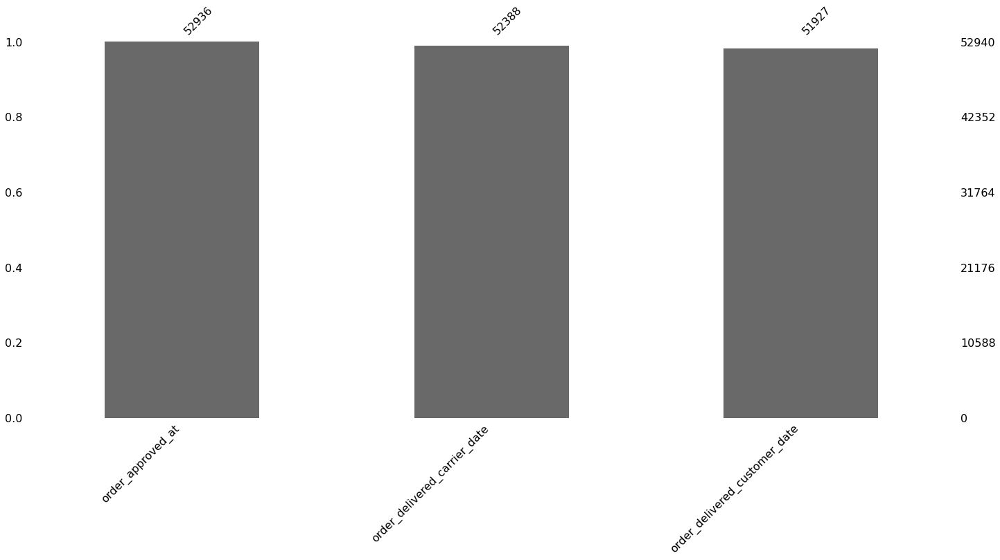

In [40]:
msno.bar(df[df.columns[df.isnull().any()]]);

In [57]:
df.isna().sum()

order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                   4
order_delivered_carrier_date      552
order_delivered_customer_date    1013
order_estimated_delivery_date       0
review_id                           0
review_score                        0
review_creation_date                0
review_answer_timestamp             0
customer_unique_id                  0
customer_zip_code_prefix            0
customer_city                       0
customer_state                      0
seller_id_x                         0
seller_zip_code_prefix              0
seller_city                         0
seller_state                        0
order_item_id                       0
product_id                          0
seller_id_y                         0
shipping_limit_date                 0
price                               0
freight_value                       0
product_name

## 3.1 Profile report

#### Quick and easy to understand overview of the data we are given

In [43]:
pr = ProfileReport(df)
pr

Summarize dataset:   0%|          | 0/52 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## 4. Data engineering and data cleaning

#### We will drop columns that contain information in Portuguese that are object-like

In [9]:
df = df.drop('review_comment_title', axis=1)
df = df.drop('review_comment_message', axis=1)
df = df.drop('product_category_name', axis=1)

#### We need to ask ourselves, how should we fill the missing data.

#### 4.1 Missing data on _order_approved_at_

In [58]:
df[df.order_approved_at.isna()]

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,review_id,review_score,review_creation_date,review_answer_timestamp,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,seller_id_x,seller_zip_code_prefix,seller_city,seller_state,order_item_id,product_id,seller_id_y,shipping_limit_date,price,freight_value,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,payment_sequential,payment_type,payment_installments,payment_value
2827,c1d4211b3dae76144deccd6c74144a88,684cb238dc5b5d6366244e0e0776b450,delivered,2017-01-19 12:48:08,NaN,2017-01-25 14:56:50,2017-01-30 18:16:01,2017-03-01 00:00:00,a8353da830468c234d99152e0b714fed,4.0,2017-02-01 00:00:00,2017-02-03 11:18:15,6ff8b0d7b35d5c945633b8d60165691b,11030,santos,SP,1c5e4e49b9079480255b49d50aac1aa9,11030,santos,SP,1,5ab02ca028398131a5ae91401eb49788,80e6699fe29150b372a0c8a1ebf7dcc8,2017-01-23 12:48:08,39.99,14.52,33.0,1322.0,2.0,700.0,26.0,16.0,21.0,sports_leisure,1,boleto,1,54.51
7578,d69e5d356402adc8cf17e08b5033acfb,68d081753ad4fe22fc4d410a9eb1ca01,delivered,2017-02-19 01:28:47,NaN,2017-02-23 03:11:48,2017-03-02 03:41:58,2017-03-27 00:00:00,6540ad5bc5a8bfc9ede2d495bfb940dd,5.0,2017-03-03 00:00:00,2017-03-04 21:06:06,2e0a2166aa23da2472c6a60c4af6f7a6,3573,sao paulo,SP,4830e40640734fc1c52cd21127c341d4,3573,sao paulo,SP,1,cae2e38942c8489d9d7a87a3f525c06b,cca3071e3e9bb7d12640c9fbe2301306,2017-02-26 01:28:47,149.80,13.63,54.0,586.0,1.0,1700.0,33.0,8.0,23.0,furniture_decor,1,boleto,1,163.43
29840,88083e8f64d95b932164187484d90212,f67cd1a215aae2a1074638bbd35a223a,delivered,2017-02-18 22:49:19,NaN,2017-02-22 11:31:06,2017-03-02 12:06:06,2017-03-21 00:00:00,331c2fea3f2c1512a9ca1889436a6904,4.0,2017-03-03 00:00:00,2017-03-04 03:45:57,bc1896dc77f49e6dec880445a9b443a3,21020,rio de janeiro,RJ,a4bd6e9adf39b63f43dc545d3ca1f53d,21020,rio de janeiro,RJ,1,8c5876b1c7768217964f353bc7e64393,0db783cfcd3b73998abc6e10e59a102f,2017-02-22 21:49:19,49.00,14.52,61.0,440.0,1.0,250.0,18.0,3.0,28.0,telephony,1,boleto,1,127.04
29841,88083e8f64d95b932164187484d90212,f67cd1a215aae2a1074638bbd35a223a,delivered,2017-02-18 22:49:19,NaN,2017-02-22 11:31:06,2017-03-02 12:06:06,2017-03-21 00:00:00,331c2fea3f2c1512a9ca1889436a6904,4.0,2017-03-03 00:00:00,2017-03-04 03:45:57,bc1896dc77f49e6dec880445a9b443a3,21020,rio de janeiro,RJ,a4bd6e9adf39b63f43dc545d3ca1f53d,21020,rio de janeiro,RJ,2,8c5876b1c7768217964f353bc7e64393,0db783cfcd3b73998abc6e10e59a102f,2017-02-22 21:49:19,49.00,14.52,61.0,440.0,1.0,250.0,18.0,3.0,28.0,telephony,1,boleto,1,127.04


#### As it is only 4 rows, we will simply just drop those.

In [66]:
df = df.drop(df[df.order_approved_at.isna()].index, axis=0)

#### 4.2 Missing data on _order_delivered_carrier_date_

In [70]:
subset = df[df.order_delivered_carrier_date.isna()]
subset

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,review_id,review_score,review_creation_date,review_answer_timestamp,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,seller_id_x,seller_zip_code_prefix,seller_city,seller_state,order_item_id,product_id,seller_id_y,shipping_limit_date,price,freight_value,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,payment_sequential,payment_type,payment_installments,payment_value
234,a402af38a74c44926247db438245d95c,3ba47b09546c2da91ef141efce2d5888,canceled,2018-01-30 22:12:10,2018-01-30 22:34:14,NaN,NaN,2018-03-06 00:00:00,b18204ed1b39d84c36cca10a2b45643d,2.0,2018-03-08 00:00:00,2018-03-08 10:27:58,b8c37ee810b38c416022e1c9f51e740c,32140,contagem,MG,9bf11dfc0bec77e5a23028043c3c5a8f,32140,contagem,MG,1,25179680ecacb54a036e9cdd27459da3,b7cc6c5e001441ae8cdd5c69a480cbe4,2018-02-05 22:32:39,199.00,83.25,42.0,442.0,4.0,8450.0,78.0,19.0,49.0,musical_instruments,1,credit_card,5,282.25
256,9dc0a33bcfa9c6bfa29e7434029a8631,36ed9379299c45eda07acf2c5012e28e,invoiced,2017-10-01 12:47:42,2017-10-01 12:56:10,NaN,NaN,2017-10-18 00:00:00,0d05b499262e97238ac6c9ef318de64c,3.0,2017-10-20 00:00:00,2017-10-21 10:19:00,7b51de055baa302c8b306ace60f9f56e,87030,maringa,PR,804287717b9156fb7a787acd9af4fac1,87030,maringa,PR,1,fc470dc1924bf42ce34d83187505dbe4,128639473a139ac0f3e5f5ade55873a5,2017-10-05 12:56:10,22.90,8.27,57.0,55.0,1.0,150.0,20.0,7.0,15.0,musical_instruments,1,credit_card,1,13.15
257,9dc0a33bcfa9c6bfa29e7434029a8631,36ed9379299c45eda07acf2c5012e28e,invoiced,2017-10-01 12:47:42,2017-10-01 12:56:10,NaN,NaN,2017-10-18 00:00:00,0d05b499262e97238ac6c9ef318de64c,3.0,2017-10-20 00:00:00,2017-10-21 10:19:00,7b51de055baa302c8b306ace60f9f56e,87030,maringa,PR,804287717b9156fb7a787acd9af4fac1,87030,maringa,PR,1,fc470dc1924bf42ce34d83187505dbe4,128639473a139ac0f3e5f5ade55873a5,2017-10-05 12:56:10,22.90,8.27,57.0,55.0,1.0,150.0,20.0,7.0,15.0,musical_instruments,2,voucher,1,18.02
258,9dc0a33bcfa9c6bfa29e7434029a8631,36ed9379299c45eda07acf2c5012e28e,invoiced,2017-10-01 12:47:42,2017-10-01 12:56:10,NaN,NaN,2017-10-18 00:00:00,0d05b499262e97238ac6c9ef318de64c,3.0,2017-10-20 00:00:00,2017-10-21 10:19:00,7b51de055baa302c8b306ace60f9f56e,87030,maringa,PR,88460e8ebdecbfecb5f9601833981930,87030,maringa,PR,1,fc470dc1924bf42ce34d83187505dbe4,128639473a139ac0f3e5f5ade55873a5,2017-10-05 12:56:10,22.90,8.27,57.0,55.0,1.0,150.0,20.0,7.0,15.0,musical_instruments,1,credit_card,1,13.15
259,9dc0a33bcfa9c6bfa29e7434029a8631,36ed9379299c45eda07acf2c5012e28e,invoiced,2017-10-01 12:47:42,2017-10-01 12:56:10,NaN,NaN,2017-10-18 00:00:00,0d05b499262e97238ac6c9ef318de64c,3.0,2017-10-20 00:00:00,2017-10-21 10:19:00,7b51de055baa302c8b306ace60f9f56e,87030,maringa,PR,88460e8ebdecbfecb5f9601833981930,87030,maringa,PR,1,fc470dc1924bf42ce34d83187505dbe4,128639473a139ac0f3e5f5ade55873a5,2017-10-05 12:56:10,22.90,8.27,57.0,55.0,1.0,150.0,20.0,7.0,15.0,musical_instruments,2,voucher,1,18.02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52288,ed3b18e876bbc16bfe330cd934aa0f68,ee76d186862db08ec487d67f0e5c7bc4,canceled,2017-09-11 20:07:36,2017-09-11 20:23:37,NaN,NaN,2017-10-02 00:00:00,86ecdb1c61cc0479ca3150564e0d811f,3.0,2017-10-04 00:00:00,2017-10-04 13:38:41,03b2cffef7bf1140a4dc136a673d6b11,14403,franca,SP,9d7a1d34a5052409006425275ba1c2b4,14403,franca,SP,1,491067a4bc3ca4303e9fba74d629412c,5075aaa8404020ae6aa8bf4792099b41,2017-09-19 20:23:37,49.99,19.21,55.0,314.0,1.0,4400.0,16.0,25.0,23.0,drinks,1,credit_card,1,69.20
52462,078f6a01964ee122ef20881df839af31,2b7ae7a532ff538ce88f6bfdd2cb564c,canceled,2018-08-06 11:06:21,2018-08-06 11:15:27,NaN,NaN,2018-08-16 00:00:00,815018ecb191fd9d1cadd856c1447762

In [72]:
subset.order_status.value_counts()

canceled       192
invoiced       188
processing     165
approved         4
unavailable      3
Name: order_status, dtype: int64

#### As you can see, based on the _order\_status_, most of the data missing on _order_delivered_carrier_date_ is due to the fact, that the delivery was either canceled, invoiced or currently proccessed. For those rows